# Imports

In [53]:
import hvac_data_gen as hvdg
from datetime import datetime, timedelta
import plotly.express as px
import stumpy
import pandas as pd

# Generate HVAC data

In [54]:
generator = hvdg.HVACDataGenerator(seed=10)


In [55]:

anomaly_config = [
        {
            'unit': 1,
            'type': 'lag',
            'start_day': 2,
            'start_hour': 8,
            'duration_hours': 48,
            'params': {'lag_minutes': 60*3}
        },
    ]
# anomaly_config = [
#         {
#             'unit': 1,
#             'type': 'frequency',
#             'start_day': 0,
#             'start_hour': 8,
#             'duration_hours': 24*5,
#             'params': {'frequency_multiplier': 0.2}
#         },
#     ]
    
single_container_df = generator.generate_container_data(
    container_id=0,
    start_time=datetime(2026, 1, 15),
    duration_days=5,
    anomaly_config=anomaly_config
)
px.line(single_container_df, x='timestamp_et', y='TmpRet', color='HVACNum') # mode='line')

# Euclidean Distance 

In [88]:
import numpy as np
single_container_df['TmpRet_smooth'] = single_container_df.groupby(['container_id', 'HVACNum'])['TmpRet'].transform(
    lambda x: x.rolling(window=10).mean()
)
df = single_container_df.dropna().copy(deep=True)
df_pivot = df.pivot(index='timestamp_et', columns='HVACNum', values='TmpRet_smooth')
window_size = 60
for i in [0, 1, 2]:
    for j in range(i+1, 3):
        df_pivot[f'dist_{i}_{j}'] = np.sqrt(
            ((df_pivot[i] - df_pivot[j])**2).rolling(window_size).sum()
        )

In [89]:
rows = []
for hvac in [0, 1, 2]:
    temp = pd.DataFrame({'timestamp_et': df_pivot.index})
    temp['HVACNum'] = hvac
    temp['TmpRet'] = df_pivot[hvac].values
    for other in [u for u in [0, 1, 2]]:
        pair = tuple(sorted([hvac, other]))
        if hvac != other:
            temp[f'dist_to_{other}'] = df_pivot[f'dist_{pair[0]}_{pair[1]}'].values
        else:
            temp[f'dist_to_{other}'] = 0 
    rows.append(temp)

df_unraveled = pd.concat(rows, ignore_index=True)
df_unraveled['hvacnum_ts'] = df_unraveled['HVACNum'].astype(str) + '_' + df_unraveled['timestamp_et'].astype(str)
df_unraveled = df_unraveled.set_index('hvacnum_ts').dropna()
df_unraveled

,timestamp_et,HVACNum,TmpRet,dist_to_0,dist_to_1,dist_to_2
hvacnum_ts,,,,,,
0_2026-01-15 01:08:00,2026-01-15 01:08:00,0,53.598693,0.000000,8.442478,21.670472
0_2026-01-15 01:09:00,2026-01-15 01:09:00,0,53.610401,0.000000,8.441023,21.677099
0_2026-01-15 01:10:00,2026-01-15 01:10:00,0,53.605638,0.000000,8.442600,21.680976
0_2026-01-15 01:11:00,2026-01-15 01:11:00,0,53.617496,0.000000,8.446127,21.686614
0_2026-01-15 01:12:00,2026-01-15 01:12:00,0,53.608583,0.000000,8.448129,21.692735
...,...,...,...,...,...,...
2_2026-01-19 23:55:00,2026-01-19 23:55:00,2,50.671508,21.856337,13.454433,0.000000
2_2026-01-19 23:56:00,2026-01-19 23:56:00,2,50.489029,21.911960,13.513399,0.000000
2_2026-01-19 23:57:00,2026-01-19 23:57:00,2,50.330453,21.987643,13.592314,0.000000


In [90]:
px.histogram(df_unraveled['dist_to_0'])

In [91]:
threshold = df_unraveled['dist_to_2'].mean() + 1.5 * df_unraveled['dist_to_2'].std()
is_anomaly = df_unraveled['dist_to_2'] > threshold
is_anomaly


hvacnum_ts
0_2026-01-15 01:08:00    False
0_2026-01-15 01:09:00    False
0_2026-01-15 01:10:00    False
0_2026-01-15 01:11:00    False
0_2026-01-15 01:12:00    False
                         ...  
2_2026-01-19 23:55:00    False
2_2026-01-19 23:56:00    False
2_2026-01-19 23:57:00    False
2_2026-01-19 23:58:00    False
2_2026-01-19 23:59:00    False
Name: dist_to_2, Length: 21396, dtype: bool

In [92]:
threshold

39.8681777565305

In [93]:
px.line(is_anomaly)

# Isolation Forest
## On Euclidean distance

In [94]:
from TSB_AD.model_wrapper import run_Unsupervise_AD
from TSB_AD.evaluation.metrics import get_metrics

In [95]:

AD_Name =  'IForest'   # It can be replaced with any anomaly detector availale in TSB-AD
feat_cols = ['dist_0_1', 'dist_0_2', 
        'dist_1_2']
data = df_pivot['dist_0_1'].dropna().values.astype(float)
data = data.reshape(data.shape[0],1)


In [96]:
df_unraveled['anomaly_score'] = run_Unsupervise_AD(AD_Name, df_unraveled[['dist_to_2']], normalize=True) 

In [97]:
px.line(df_unraveled, y=['dist_to_0', 'dist_to_1', 'dist_to_2'])

In [98]:
df_unraveled.head()

,timestamp_et,HVACNum,TmpRet,dist_to_0,dist_to_1,dist_to_2,anomaly_score
hvacnum_ts,,,,,,,
0_2026-01-15 01:08:00,2026-01-15 01:08:00,0,53.598693,0.0,8.442478,21.670472,-0.156399
0_2026-01-15 01:09:00,2026-01-15 01:09:00,0,53.610401,0.0,8.441023,21.677099,-0.156399
0_2026-01-15 01:10:00,2026-01-15 01:10:00,0,53.605638,0.0,8.442600,21.680976,-0.156399
0_2026-01-15 01:11:00,2026-01-15 01:11:00,0,53.617496,0.0,8.446127,21.686614,-0.156399
0_2026-01-15 01:12:00,2026-01-15 01:12:00,0,53.608583,0.0,8.448129,21.692735,-0.156399


In [99]:
px.line(df_unraveled, y=['TmpRet'], color='HVACNum'
        )

In [100]:
df_unraveled['is_anomaly'] = df_unraveled['anomaly_score'] > 0

In [101]:
px.line(df_unraveled, y=['anomaly_score'], color='HVACNum'
        )

## On Raw Data

In [104]:
df_pivot.head()

HVACNum,0,1,2,dist_0_1,dist_0_2,dist_1_2
timestamp_et,,,,,,
2026-01-15 00:09:00,53.577822,52.457653,50.774637,NaN,NaN,NaN
2026-01-15 00:10:00,53.554316,52.472006,50.770206,NaN,NaN,NaN
2026-01-15 00:11:00,53.543757,52.482397,50.765742,NaN,NaN,NaN
2026-01-15 00:12:00,53.519995,52.475517,50.758160,NaN,NaN,NaN
2026-01-15 00:13:00,53.527893,52.462560,50.745842,NaN,NaN,NaN


In [139]:

feat_cols = ['dist_0_1', 'dist_0_2', 
        'dist_1_2']
train_data = df_pivot[feat_cols + [0,1,2]].dropna()
train_data.head()

HVACNum,dist_0_1,dist_0_2,dist_1_2,0,1,2
timestamp_et,,,,,,
2026-01-15 01:08:00,8.442478,21.670472,13.232112,53.598693,52.497492,50.758497
2026-01-15 01:09:00,8.441023,21.677099,13.240114,53.610401,52.501248,50.756438
2026-01-15 01:10:00,8.442600,21.680976,13.242413,53.605638,52.511098,50.791502
2026-01-15 01:11:00,8.446127,21.686614,13.244492,53.617496,52.528437,50.795816
2026-01-15 01:12:00,8.448129,21.692735,13.248626,53.608583,52.548041,50.799083


In [153]:
train_data['iforest_score_1'] = run_Unsupervise_AD('IForest', train_data[feat_cols], contamination=0.2)
train_data['iforest_score_2'] = run_Unsupervise_AD('IForest', train_data[feat_cols + [0, 1, 2]], contamination=0.2)
train_data['iforest_score_3'] = run_Unsupervise_AD('IForest', train_data[[0, 1, 2]], contamination=0.4)

In [154]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=3, cols=1, shared_xaxes=True)

for col in [0,1,2]:
    fig.add_trace(go.Scatter(y=train_data[col], name=col), row=1, col=1)

for col in feat_cols:
    fig.add_trace(go.Scatter(y=train_data[col], name=col), row=2, col=1)

fig.add_trace(go.Scatter(y=train_data['iforest_score_2'], name='iforest_score(all_cols)'), row=3, col=1)
fig.add_trace(go.Scatter(y=train_data['iforest_score_1'], name=f'iforest_score{feat_cols}'), row=3, col=1)
fig.add_trace(go.Scatter(y=train_data['iforest_score_3'], name='iforest_score(temp_cols)'), row=3, col=1)


fig.update_layout(height=800)
fig.show()

# More Analysis

In [44]:
anomaly_config = [
        {
            'unit': 1,
            'type': 'lag',
            'start_day': 2,
            'start_hour': 8,
            'duration_hours': 48,
            'params': {'lag_minutes': 60*3}
        },
    ]
# anomaly_config = [
#         {
#             'unit': 1,
#             'type': 'frequency',
#             'start_day': 0,
#             'start_hour': 8,
#             'duration_hours': 24*5,
#             'params': {'frequency_multiplier': 0.2}
#         },
#     ]
    
single_container_df = generator.generate_container_data(
    container_id=0,
    start_time=datetime(2026, 1, 15),
    duration_days=5,
    anomaly_config=anomaly_config
)
px.line(single_container_df, x='timestamp_et', y='TmpRet', color='HVACNum') # mode='line')

# Matrix Profile

In [4]:
single_container_df['TmpRet_smooth'] = single_container_df.groupby(['container_id', 'HVACNum'])['TmpRet'].transform(
    lambda x: x.rolling(window=10).mean()
)

In [5]:

px.line(single_container_df, x='timestamp_et', y='TmpRet', color='HVACNum') # mode='line')

- transform data s.t. all hvac units are 
- index unit_ts

In [6]:
df = single_container_df.dropna().copy(deep=True)
df.head()


,timestamp_et,HVACNum,TmpRet,anomaly,anomaly_type,container_id,TmpRet_smooth
27,2026-01-15 00:09:00,0,53.556250,False,normal,0,53.577822
28,2026-01-15 00:09:00,1,52.531346,False,normal,0,52.457653
29,2026-01-15 00:09:00,2,50.628054,False,normal,0,50.774637
30,2026-01-15 00:10:00,0,53.471597,False,normal,0,53.554316
31,2026-01-15 00:10:00,1,52.745722,False,normal,0,52.472006


In [7]:
df_pivot = df.pivot(index='timestamp_et', columns='HVACNum', values='TmpRet_smooth')

In [8]:
df_pivot.head()

HVACNum,0,1,2
timestamp_et,,,
2026-01-15 00:09:00,53.577822,52.457653,50.774637
2026-01-15 00:10:00,53.554316,52.472006,50.770206
2026-01-15 00:11:00,53.543757,52.482397,50.765742
2026-01-15 00:12:00,53.519995,52.475517,50.758160
2026-01-15 00:13:00,53.527893,52.462560,50.745842


In [9]:
import numpy as np
window_size = 60
for i in [0, 1, 2]:
    for j in range(i+1, 3):
        df_pivot[f'dist_{i}_{j}'] = np.sqrt(
            ((df_pivot[i] - df_pivot[j])**2).rolling(window_size).sum()
        )

In [10]:
df_pivot.head()

HVACNum,0,1,2,dist_0_1,dist_0_2,dist_1_2
timestamp_et,,,,,,
2026-01-15 00:09:00,53.577822,52.457653,50.774637,NaN,NaN,NaN
2026-01-15 00:10:00,53.554316,52.472006,50.770206,NaN,NaN,NaN
2026-01-15 00:11:00,53.543757,52.482397,50.765742,NaN,NaN,NaN
2026-01-15 00:12:00,53.519995,52.475517,50.758160,NaN,NaN,NaN
2026-01-15 00:13:00,53.527893,52.462560,50.745842,NaN,NaN,NaN


In [ ]:
# Unravel df_pivot so each row is one HVAC unit at one timestamp
rows = []
for hvac in [0, 1, 2]:
    temp = pd.DataFrame({'timestamp_et': df_pivot.index})
    temp['HVACNum'] = hvac
    temp['TmpRet'] = df_pivot[hvac].values
    for other in [u for u in [0, 1, 2] if u != hvac]:
        pair = tuple(sorted([hvac, other]))
        temp[f'dist_to_{other}'] = df_pivot[f'dist_{pair[0]}_{pair[1]}'].values
    rows.append(temp)

df_unraveled = pd.concat(rows, ignore_index=True)
df_unraveled['hvacnum_ts'] = df_unraveled['HVACNum'].astype(str) + '_' + df_unraveled['timestamp_et'].astype(str)
df_unraveled = df_unraveled.set_index('hvacnum_ts')
df_unraveled

In [17]:
px.line(df, x='timestamp_et', y='TmpRet', color='HVACNum') # mode='line')

In [39]:
px.line(df_pivot, y='dist_0_2')

<Axes: >

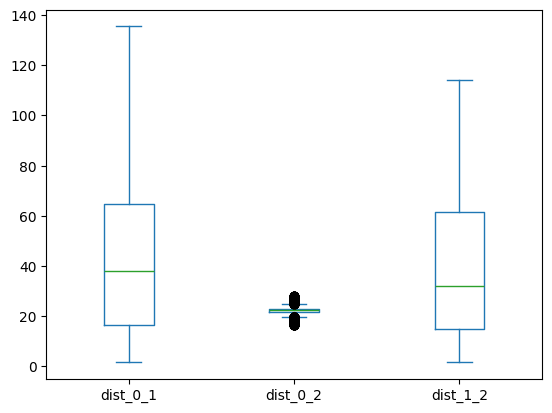

In [16]:
df_pivot[['dist_0_1', 'dist_0_2', 
        'dist_1_2']
].plot.box()

In [37]:
dist_cols = ['dist_0_1', 'dist_1_2', 'dist_0_2']
df_pivot[dist_cols] = df_pivot[dist_cols].rolling(60*2).mean()

In [46]:
df_pivot.tail()

HVACNum,0,1,2,dist_0_1,dist_0_2,dist_1_2
timestamp_et,,,,,,
2026-01-19 23:55:00,53.642152,51.208284,50.671508,6.570910,21.981179,16.114045
2026-01-19 23:56:00,53.658330,51.209217,50.489029,6.656771,21.978898,16.010173
2026-01-19 23:57:00,53.640783,51.207817,50.330453,6.743330,21.976645,15.906155
2026-01-19 23:58:00,53.632871,51.204083,50.145574,6.830570,21.974423,15.802004
2026-01-19 23:59:00,53.626462,51.198016,49.975633,6.918474,21.972234,15.697731


In [40]:
px.line(df_pivot, y='dist_0_1')

<Axes: >

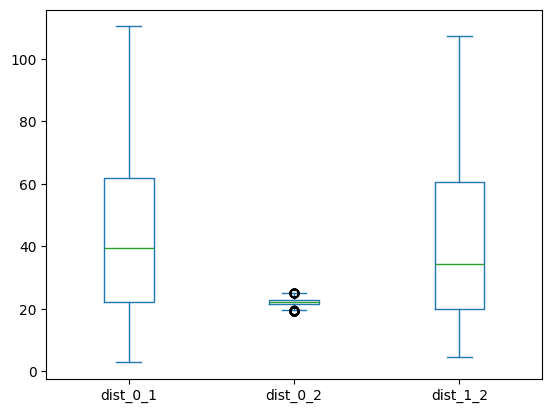

In [ ]:
df_pivot[
    ['dist_0_1', 'dist_0_2', 
        'dist_1_2']
].plot.box()

In [ ]:
anomalous_ts = df_pivot[df_pivot['dist_1_2'] >= ]

In [26]:
df_long = df_pivot.reset_index().melt(
    id_vars=['timestamp_et', 'dist_0_1', 'dist_0_2', 'dist_1_2'], 
    var_name='HVACNum', 
    value_name='TmpRet'
)


In [ ]:
mp = stumpy.stump(df['TmpRet_smooth'].values, window_size, normalize=False)

In [27]:
mp.shape

(21544, 4)

In [28]:
df.shape

(21573, 7)

In [30]:
mp

mparray([[3.571778949619093, 8625, -1, 8625],
         [3.69452303849123, 1741, -1, 1741],
         [3.526109523067083, 1742, -1, 1742],
         ...,
         [0.1089220945455469, 21374, 21374, -1],
         [0.11283583099640251, 21375, 21375, -1],
         [0.11241793993518912, 21482, 21482, -1]], dtype=object)

In [33]:
mp[0, :]

mparray([3.571778949619093, 8625, -1, 8625], dtype=object)

In [34]:
px.line(mp[:, 0])

In [ ]:

print(f"\nGenerated {len(single_container_df)} records")
print(f"Anomaly records: {single_container_df['anomaly'].sum()}")
print("\nFirst few records:")
print(single_container_df.head(10))
    
    # Visualize

In [ ]:
c1 = single_container_df #[single_container_df["HVACNum"] == 2]
c1['HVACNum'] = c1['HVACNum'].astype('category')
# c1['TmpRet_smooth'] = c1['TmpRet'].groupby('HVACNum').rolling(window=20, center=True).mean()
c1['TmpRet_smooth'] = c1.groupby(['container_id', 'HVACNum'])['TmpRet'].transform(
    lambda x: x.rolling(window=10).mean()
)


In [ ]:
single_container_df[single_container_df['anomaly']]

In [27]:
import hvac_data_gen as hvdg
from datetime import datetime
import random

# Set parameters
num_containers = 100  # Total number of containers
duration_days = 7
start_date = '2026-01-12'
seed = 42

# Set random seed for reproducibility
random.seed(seed)

# Calculate number of containers per category
total = num_containers
normal_containers = int(total * 0.95)  # 95%
lag_containers = int(total * 0.02)     # 2%
freq_containers = int(total * 0.03)    # 3%

# Adjust to ensure we hit exactly num_containers
# Add any remaining to normal
remaining = total - (normal_containers + lag_containers + freq_containers)
normal_containers += remaining

print(f"Total containers: {num_containers}")
print(f"Normal: {normal_containers} ({100*normal_containers/total:.1f}%)")
print(f"Lag anomaly: {lag_containers} ({100*lag_containers/total:.1f}%)")
print(f"Frequency anomaly: {freq_containers} ({100*freq_containers/total:.1f}%)")

# Create container IDs and shuffle them
container_ids = list(range(num_containers))
random.shuffle(container_ids)

# Assign anomaly configurations
anomaly_configs = {}

# Assign lag anomalies to first lag_containers
for i in range(lag_containers):
    container_id = container_ids[i]
    anomaly_configs[container_id] = [{
        'unit': random.randint(0, 2),  # Random unit
        'type': 'lag',
        'start_day': random.randint(1, duration_days - 2),
        'start_hour': random.randint(0, 23),
        'duration_hours': random.randint(12, 48),  # 12-48 hours
        'params': {'lag_minutes': random.randint(60, 180)}  # 1-3 hours lag
    }]

# Assign frequency anomalies to next freq_containers
for i in range(lag_containers, lag_containers + freq_containers):
    container_id = container_ids[i]
    anomaly_configs[container_id] = [{
        'unit': random.randint(0, 2),  # Random unit
        'type': 'frequency',
        'start_day': random.randint(1, duration_days - 2),
        'start_hour': random.randint(0, 23),
        'duration_hours': random.randint(12, 48),  # 12-48 hours
        'params': {'frequency_multiplier': random.uniform(1.5, 3.0)}  # 1.5x-3x faster
    }]

# Remaining containers are normal (no anomaly config needed)

print(f"\nConfigured anomalies for {len(anomaly_configs)} containers")

# Generate the dataset
print("\nGenerating dataset...")
generator = hvdg.HVACDataGenerator(seed=seed)

dataset = generator.generate_dataset(
    num_containers=num_containers,
    start_date=start_date,
    duration_days=duration_days,
    anomaly_probability=0.0,  # We're manually controlling anomalies
    anomaly_configs=anomaly_configs
)

# Verify the distribution
print(f"\n{'='*70}")
print("Dataset Summary:")
print(f"{'='*70}")
print(f"Total records: {len(dataset):,}")
print(f"Containers: {dataset['container_id'].nunique()}")
print(f"Date range: {dataset['timestamp_et'].min()} to {dataset['timestamp_et'].max()}")

# Anomaly statistics
total_anomalies = dataset['anomaly'].sum()
print(f"\nTotal anomaly records: {total_anomalies:,} ({100*total_anomalies/len(dataset):.2f}%)")

# Count containers with anomalies by type
containers_with_lag = dataset[dataset['anomaly_type'] == 'lag']['container_id'].nunique()
containers_with_freq = dataset[dataset['anomaly_type'] == 'frequency']['container_id'].nunique()
containers_normal = dataset[dataset['anomaly_type'] == 'normal']['container_id'].nunique()

print(f"\nContainers by anomaly type:")
print(f"  Normal: {containers_normal}")
print(f"  Lag: {containers_with_lag}")
print(f"  Frequency: {containers_with_freq}")

# Records by anomaly type
print(f"\nRecords by anomaly type:")
print(dataset['anomaly_type'].value_counts())

Total containers: 100
Normal: 95 (95.0%)
Lag anomaly: 2 (2.0%)
Frequency anomaly: 3 (3.0%)

Configured anomalies for 5 containers

Generating dataset...

Dataset Summary:
Total records: 3,024,000
Containers: 100
Date range: 2026-01-12 00:00:00 to 2026-01-18 23:59:00

Total anomaly records: 9,960 (0.33%)

Containers by anomaly type:
  Normal: 100
  Lag: 2
  Frequency: 3

Records by anomaly type:
anomaly_type
normal       3014040
frequency       5940
lag             4020
Name: count, dtype: int64


In [28]:
dataset['container_id'].unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [29]:
dataset[dataset['anomaly_type'] != 'normal']

,timestamp_et,HVACNum,TmpRet,anomaly,anomaly_type,container_id
296102,2026-01-17 13:00:00,2,67.620961,True,frequency,9
296105,2026-01-17 13:01:00,2,67.609091,True,frequency,9
296108,2026-01-17 13:02:00,2,67.357240,True,frequency,9
296111,2026-01-17 13:03:00,2,67.337973,True,frequency,9
296114,2026-01-17 13:04:00,2,67.152184,True,frequency,9
...,...,...,...,...,...,...
2770186,2026-01-16 05:55:00,1,53.874433,True,frequency,91
2770189,2026-01-16 05:56:00,1,53.582802,True,frequency,91
2770192,2026-01-16 05:57:00,1,53.556247,True,frequency,91
2770195,2026-01-16 05:58:00,1,53.417731,True,frequency,91


In [30]:
import plotly.express as px

# Plot containers with anomalies
sample_containers = random.sample(container_ids[:10], min(5, 10))
sample_data = dataset[dataset['container_id'].isin(sample_containers)]

fig = px.line(sample_data, x='timestamp_et', y='TmpRet', 
              color='HVACNum', facet_col='container_id', 
              facet_col_wrap=2,
              title='Sample Containers')
fig.show()

# Show distribution of anomaly types by container
anomaly_summary = dataset.groupby(['container_id', 'anomaly_type']).size().reset_index(name='count')
fig = px.bar(anomaly_summary, x='container_id', y='count', color='anomaly_type',
             title='Anomaly Distribution by Container')
fig.show()

In [31]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd
import random

# Assuming 'dataset' is your generated HVAC dataset

# Identify containers by their primary anomaly type
def get_container_anomaly_type(df, container_id):
    """Get the primary anomaly type for a container"""
    container_data = df[df['container_id'] == container_id]
    
    # Check if container has any anomalies
    if not container_data['anomaly'].any():
        return 'normal'
    
    # Get the anomaly type (excluding 'normal')
    anomaly_types = container_data[container_data['anomaly']]['anomaly_type'].unique()
    anomaly_types = [t for t in anomaly_types if t != 'normal']
    
    if len(anomaly_types) > 0:
        return anomaly_types[0]
    return 'normal'

# Categorize all containers
container_categories = {}
for container_id in dataset['container_id'].unique():
    container_categories[container_id] = get_container_anomaly_type(dataset, container_id)

# Group containers by type
normal_containers = [k for k, v in container_categories.items() if v == 'normal']
lag_containers = [k for k, v in container_categories.items() if v == 'lag']
freq_containers = [k for k, v in container_categories.items() if v == 'frequency']

print(f"Normal containers: {len(normal_containers)}")
print(f"Lag anomaly containers: {len(lag_containers)}")
print(f"Frequency anomaly containers: {len(freq_containers)}")

# Sample containers from each type
n_samples = min(3, len(normal_containers), len(lag_containers), len(freq_containers))

random.seed(42)
sampled_normal = random.sample(normal_containers, min(n_samples, len(normal_containers)))
sampled_lag = random.sample(lag_containers, min(n_samples, len(lag_containers)))
sampled_freq = random.sample(freq_containers, min(n_samples, len(freq_containers)))

print(f"\nSampled containers:")
print(f"Normal: {sampled_normal}")
print(f"Lag: {sampled_lag}")
print(f"Frequency: {sampled_freq}")

# Plot 1: Compare one container from each type side by side
fig = make_subplots(
    rows=1, cols=3,
    subplot_titles=('Normal Container', 'Lag Anomaly', 'Frequency Anomaly'),
    shared_yaxes=True
)

colors = ['#5470C6', '#EE6666', '#5DBCD2']  # Blue, Red, Cyan

# Normal container
if sampled_normal:
    normal_data = dataset[dataset['container_id'] == sampled_normal[0]]
    for i, unit in enumerate([0, 1, 2]):
        unit_data = normal_data[normal_data['HVACNum'] == unit]
        fig.add_trace(
            go.Scatter(x=unit_data['timestamp_et'], y=unit_data['TmpRet'],
                      mode='lines', name=f'Unit {unit}', 
                      line=dict(color=colors[i]),
                      legendgroup='normal', showlegend=True),
            row=1, col=1
        )

# Lag container
if sampled_lag:
    lag_data = dataset[dataset['container_id'] == sampled_lag[0]]
    for i, unit in enumerate([0, 1, 2]):
        unit_data = lag_data[lag_data['HVACNum'] == unit]
        fig.add_trace(
            go.Scatter(x=unit_data['timestamp_et'], y=unit_data['TmpRet'],
                      mode='lines', name=f'Unit {unit}',
                      line=dict(color=colors[i]),
                      legendgroup='lag', showlegend=False),
            row=1, col=2
        )

# Frequency container
if sampled_freq:
    freq_data = dataset[dataset['container_id'] == sampled_freq[0]]
    for i, unit in enumerate([0, 1, 2]):
        unit_data = freq_data[freq_data['HVACNum'] == unit]
        fig.add_trace(
            go.Scatter(x=unit_data['timestamp_et'], y=unit_data['TmpRet'],
                      mode='lines', name=f'Unit {unit}',
                      line=dict(color=colors[i]),
                      legendgroup='freq', showlegend=False),
            row=1, col=3
        )

fig.update_xaxes(title_text="Time", row=1, col=1)
fig.update_xaxes(title_text="Time", row=1, col=2)
fig.update_xaxes(title_text="Time", row=1, col=3)
fig.update_yaxes(title_text="Temperature (°F)", row=1, col=1)

fig.update_layout(height=500, width=1400, 
                  title_text="Comparison of Anomaly Types",
                  hovermode='x unified')
fig.show()

Normal containers: 95
Lag anomaly containers: 2
Frequency anomaly containers: 3

Sampled containers:
Normal: [85, 15]
Lag: [41, 42]
Frequency: [9, 91]
